<a href="https://colab.research.google.com/github/pulkit22022000/Credit-Card-Fraud-Detection/blob/main/Credit_Card_Fraud_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Libraries

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

import os

import warnings
warnings.filterwarnings("ignore")

# Data Overview

Google drive link to the dataset : https://drive.google.com/file/d/1Bha_8vbHTRTUrwMGXGCFgdLehe2dnKzo/view?usp=drive_link

In [6]:
df = pd.read_csv("/content/drive/MyDrive/card_transdata.csv")
df.head()

,distance_from_home,distance_from_last_transaction,ratio_to_median_purchase_price,repeat_retailer,used_chip,used_pin_number,online_order,fraud
0,57.877857,0.311140,1.945940,1.0,1.0,0.0,0.0,0.0
1,10.829943,0.175592,1.294219,1.0,0.0,0.0,0.0,0.0
2,5.091079,0.805153,0.427715,1.0,0.0,0.0,1.0,0.0
3,2.247564,5.600044,0.362663,1.0,1.0,0.0,1.0,0.0
4,44.190936,0.566486,2.222767,1.0,1.0,0.0,1.0,0.0


In [7]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 8 columns):
 #   Column                          Non-Null Count    Dtype  
---  ------                          --------------    -----  
 0   distance_from_home              1000000 non-null  float64
 1   distance_from_last_transaction  1000000 non-null  float64
 2   ratio_to_median_purchase_price  1000000 non-null  float64
 3   repeat_retailer                 1000000 non-null  float64
 4   used_chip                       1000000 non-null  float64
 5   used_pin_number                 1000000 non-null  float64
 6   online_order                    1000000 non-null  float64
 7   fraud                           1000000 non-null  float64
dtypes: float64(8)
memory usage: 61.0 MB


In [9]:
df.isna().sum()

distance_from_home                0
distance_from_last_transaction    0
ratio_to_median_purchase_price    0
repeat_retailer                   0
used_chip                         0
used_pin_number                   0
online_order                      0
fraud                             0
dtype: int64

In [10]:
df.duplicated().sum()

0

the dataset has no missing values or duplicates.

In [11]:
df.describe()

,distance_from_home,distance_from_last_transaction,ratio_to_median_purchase_price,repeat_retailer,used_chip,used_pin_number,online_order,fraud
count,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000
mean,26.628792,5.036519,1.824182,0.881536,0.350399,0.100608,0.650552,0.087403
std,65.390784,25.843093,2.799589,0.323157,0.477095,0.300809,0.476796,0.282425
min,0.004874,0.000118,0.004399,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.878008,0.296671,0.475673,1.000000,0.000000,0.000000,0.000000,0.000000
50%,9.967760,0.998650,0.997717,1.000000,0.000000,0.000000,1.000000,0.000000
75%,25.743985,3.355748,2.096370,1.000000,1.000000,0.000000,1.000000,0.000000
max,10632.723672,11851.104565,267.802942,1.000000,1.000000,1.000000,1.000000,1.000000


There are extreme outliers in numerical features.

# Features Distribution

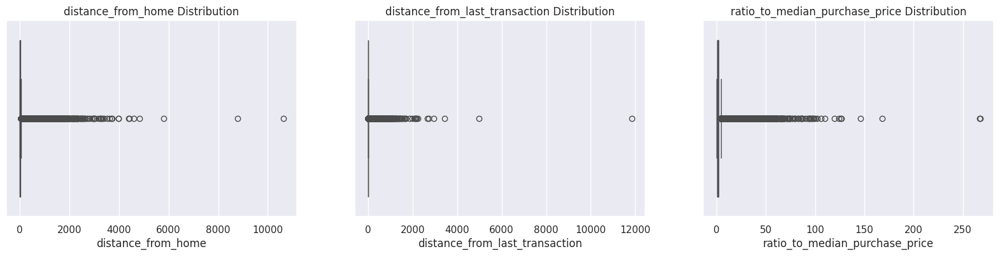

In [12]:
num_features = ['distance_from_home','distance_from_last_transaction','ratio_to_median_purchase_price']
fig,ax = plt.subplots(1,3,figsize=(20,4))
for i,col in enumerate(num_features):
    sns.boxplot(data=df,x=col,ax=ax[i])
    ax[i].set_title(f'{col} Distribution')

**Target distribution before deleting outliers**

In [13]:
df['fraud'].value_counts(normalize=True) * 100

fraud
0.0    91.2597
1.0     8.7403
Name: proportion, dtype: float64

In [14]:
df_no_outilers = df.copy()

for col in ['distance_from_home','distance_from_last_transaction','ratio_to_median_purchase_price']:
    q1 = df_no_outilers[col].quantile(0.25)
    q3 = df_no_outilers[col].quantile(0.75)
    iqr = q3 - q1
    lower = q1 - 1.5 * iqr
    upper = q3 + 1.5 * iqr
    df_no_outilers = df_no_outilers[(df_no_outilers[col]>=lower) & (df_no_outilers[col]<=upper)]

**Target distribution after deleting outliers**

In [15]:
df_no_outilers['fraud'].value_counts(normalize=True)*100

fraud
0.0    98.748828
1.0     1.251172
Name: proportion, dtype: float64

**we can see that most of outliers are fraud so dropping them will lead to losing important information. so we won't drop them.**

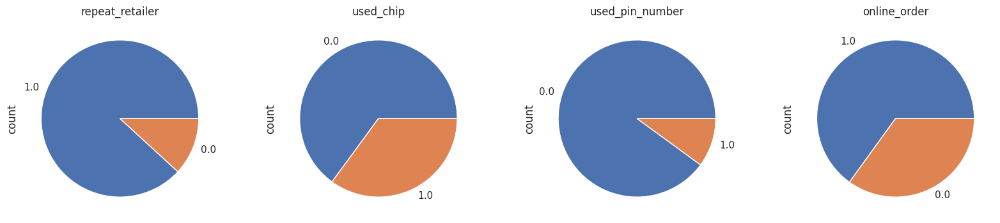

In [16]:
cat_features = ['repeat_retailer', 'used_chip','used_pin_number', 'online_order']
fig,ax = plt.subplots(1,4,figsize=(20,4))
for i,col in enumerate(cat_features):
    df[col].value_counts().plot(kind='pie',ax=ax[i],title=col)

# Target Distribution

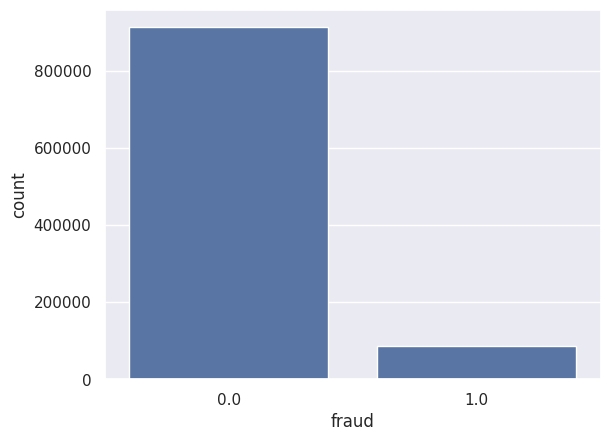

In [17]:
sns.countplot(data=df,x='fraud');

# Features Correlation with Target

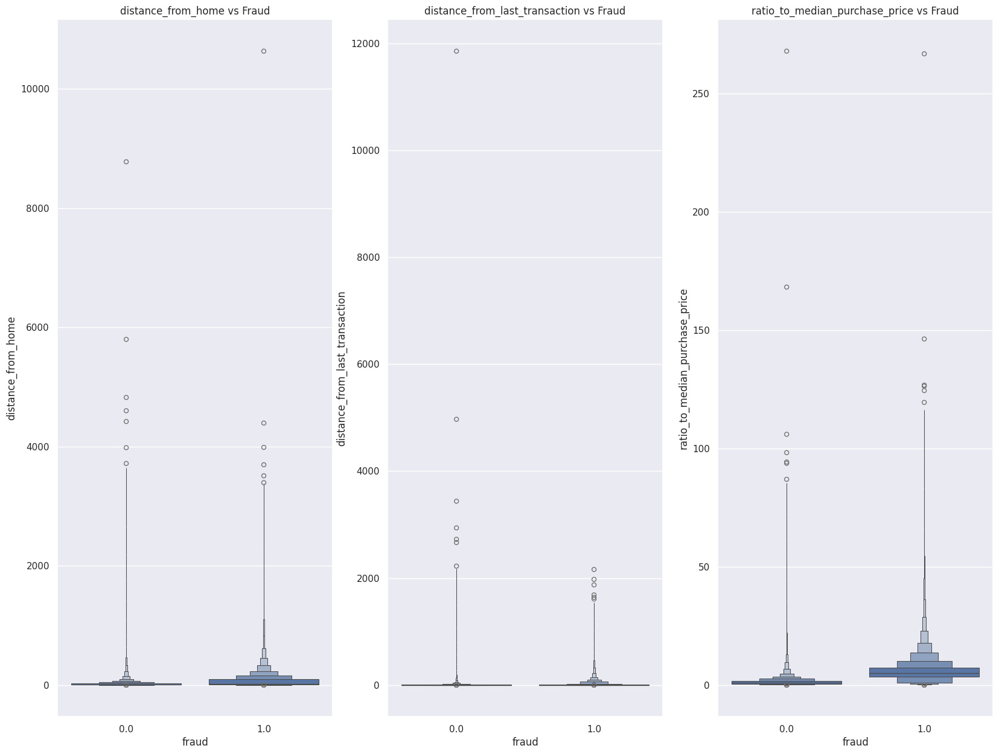

In [18]:
fig,ax = plt.subplots(1,3,figsize=(20,15))
for i,col in enumerate(num_features):
    sns.boxenplot(x=df['fraud'],y=df[col],ax=ax[i])
    ax[i].set_title(f'{col} vs Fraud')

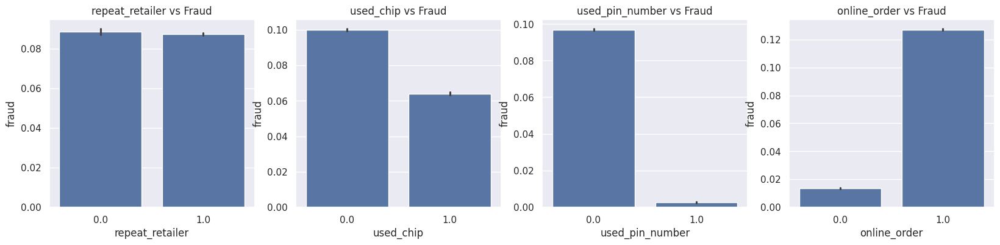

In [19]:
fig,ax = plt.subplots(1,4,figsize=(20,4))
for i,col in enumerate(cat_features):
    sns.barplot(data=df,x=col,y='fraud',ax=ax[i])
    ax[i].set_title(f'{col} vs Fraud')

Except for repeat_retailer, features have a strong correlation with the target.

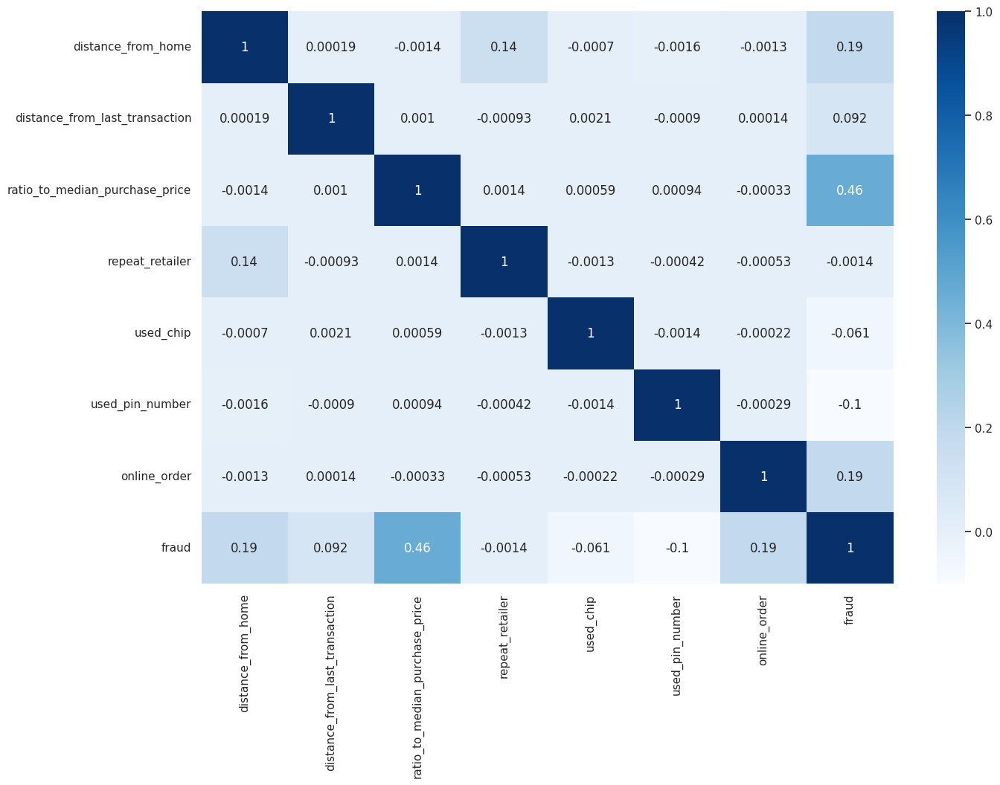

In [20]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr(),cmap='Blues',annot=True);

# Model Building

In [21]:
def validate(model,X_train,y_train,score,n):

    '''this function is to validate the model across multiple stratified splits'''

    splits = StratifiedKFold(n_splits=n)
    validate = cross_val_score(model,X_train,y_train,scoring=score,cv=splits)
    print('Cross Validation Scores: ',validate)
    print('Scores Mean: ',validate.mean())
    print('Scores Standard Deviation: ',validate.std())
    model.fit(X_train,y_train)
    return model

In [22]:
def model_tunning(model,X_train,y_train,param_grid):

    '''This function recieves a model then tune it using GridSearch
    then print the best parameters and return the best estimator'''

    grid_search = GridSearchCV(estimator=model,param_grid=param_grid,cv=5,scoring='recall')
    grid_search.fit(X_train,y_train)
    best_params = grid_search.best_params_
    best_estimator = grid_search.best_estimator_
    best_score = grid_search.best_score_
    cv_results = pd.DataFrame(grid_search.cv_results_)
    print("Best parameters are: ",best_params)
    print('Mean cross-validated recall of the best_estimator is: ',best_score)
    #print(cv_results)
    return best_estimator

In [23]:
def model_evaluation(model,X_test,y_test,color='Blues',threshold=0.5):

    '''this function is to evaluate the model based on a given threshold
    1--> print the classification report     2--> display the confusion matrix'''

    #classification report
    y_proba_test = model.predict_proba(X_test)
    y_pred_test  = (y_proba_test[:,1]>=threshold)
    print(classification_report(y_test,y_pred_test,zero_division=0))
    #confusion matrix
    plt.figure(figsize=(5,4))
    sns.heatmap(confusion_matrix(y_test,y_pred_test),cmap=color,annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')

In [24]:
def precision_recall_trade_off(model,X_test,y_test):

    '''this function is to plot the precision-recall curve then
    printing the thresholds that achieves the highest recall'''

    y_proba = model.predict_proba(X_test)
    precision ,recall ,threshold = precision_recall_curve(y_test,y_proba[:,1])
    p_r_t = pd.DataFrame({'Threshold':threshold,'Precision':precision[:-1],'Recall':recall[:-1]})
    fig = px.line(
        p_r_t,
        x='Recall',
        y='Precision',
        title='Precision-Recall Curve',
        width=700,height=500,
        hover_data=['Threshold']
    )
    fig.show()
    print(p_r_t[ (p_r_t['Recall']==1)].tail(10))

In [25]:
def roc_auc(model,X_test,y_test):

    '''this function plots the roc-auc curve and calculate the model ROC-AUC score '''

    y_proba = model.predict_proba(X_test)
    fpr ,tpr ,threshold = roc_curve(y_test,y_proba[:,1])
    fp_tp = pd.DataFrame({'Threshold':threshold,'FPR':fpr,'TPR':tpr})
    fig = px.line(
        fp_tp,
        x='FPR',
        y='TPR',
        title='ROC Curve',
        width=700,height=500,
        hover_data=['Threshold']
    )
    fig.show()
    print('Testing ROC-AUC Score: ',roc_auc_score(y_test,y_proba[:,1]))

In [26]:
from sklearn.model_selection import train_test_split , GridSearchCV ,StratifiedKFold , cross_val_score
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix , precision_recall_curve , roc_auc_score , roc_curve , classification_report

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier ,plot_tree
from sklearn.ensemble import VotingClassifier ,RandomForestClassifier ,AdaBoostClassifier ,GradientBoostingClassifier
from xgboost import XGBClassifier

# Data Splitting and Preprocessing

In [27]:
features = df.columns.drop(['fraud'])
target = 'fraud'

X = df[features]
y = df[target]

In [28]:
X_train , X_test ,y_train , y_test = train_test_split(X,y,test_size = 0.2 ,random_state = 42 ,stratify=y)

In [29]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# 1. Decision Tree Classifier

In [30]:
dec_tree = validate(DecisionTreeClassifier(random_state=42),X_train,y_train,'recall',5)

Cross Validation Scores:  [0.99978547 0.99978547 0.99978547 0.99985699 0.99992849]
Scores Mean:  0.9998283783540554
Scores Standard Deviation:  5.7211050409744465e-05


In [31]:
precision_recall_trade_off(dec_tree,X_test,y_test)

   Threshold  Precision  Recall
0        0.0   0.087405     1.0


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    730078
         1.0       1.00      1.00      1.00     69922

    accuracy                           1.00    800000
   macro avg       1.00      1.00      1.00    800000
weighted avg       1.00      1.00      1.00    800000



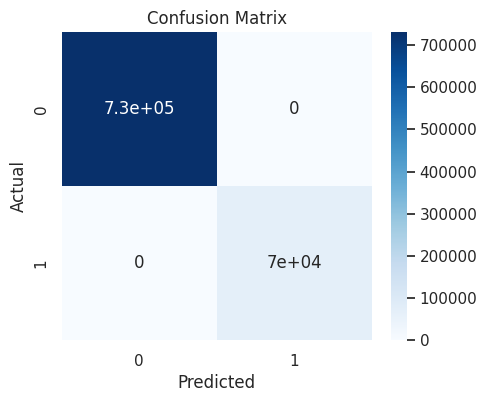

In [32]:
model_evaluation(dec_tree,X_train,y_train,'Blues')

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    182519
         1.0       1.00      1.00      1.00     17481

    accuracy                           1.00    200000
   macro avg       1.00      1.00      1.00    200000
weighted avg       1.00      1.00      1.00    200000



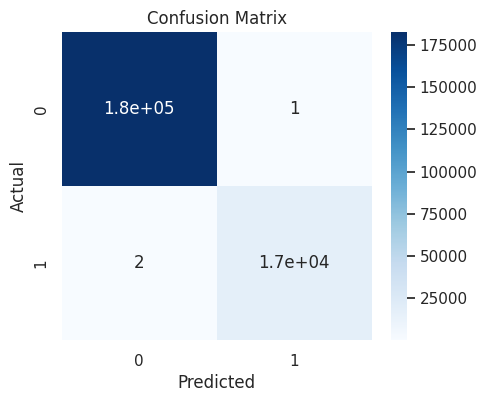

In [33]:
model_evaluation(dec_tree,X_test,y_test,'Blues')

In [34]:
roc_auc(dec_tree,X_test,y_test)

Testing ROC-AUC Score:  0.9999400555937836


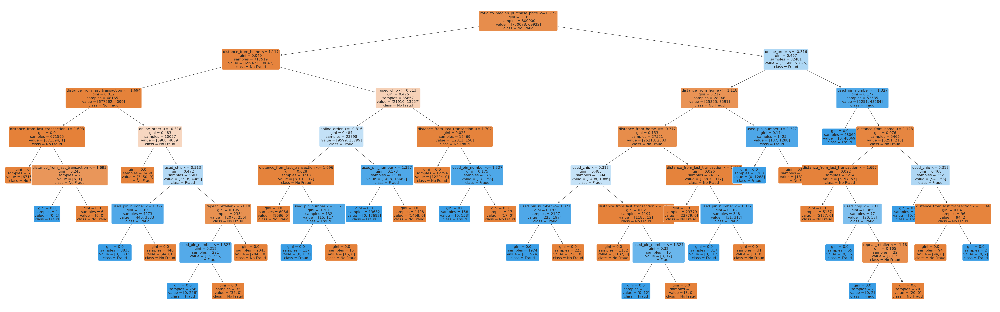

In [35]:
plt.figure(figsize=(80,25))
plot_tree(
          dec_tree,
          feature_names=X.columns,
          class_names=['No Fraud', "Fraud"],
          filled=True,
          rounded=True,
          fontsize=16
);

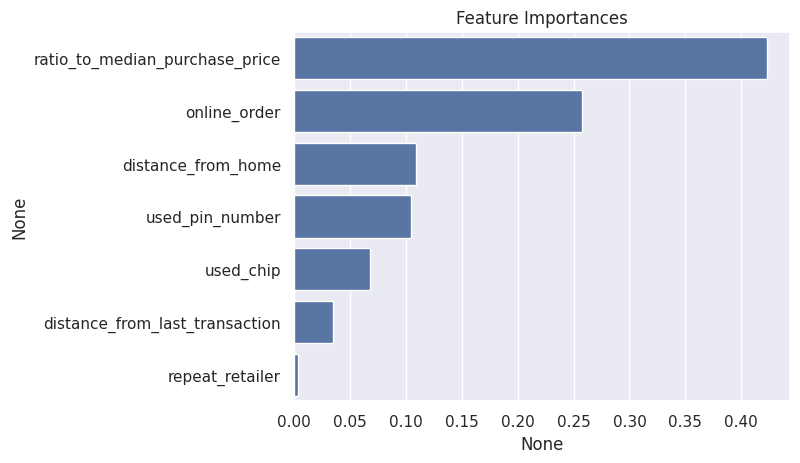

In [36]:
feat_imp_dt = pd.Series(dec_tree.feature_importances_,index=X.columns).sort_values(ascending=False)
sns.barplot(x=feat_imp_dt,y=feat_imp_dt.index)
plt.title('Feature Importances');

# 2. XGBoost Classifier

In [37]:
xgb = validate(XGBClassifier(n_estimators=500 ,random_state=42 ,n_jobs=-1),X_train,y_train,'recall',5)

Cross Validation Scores:  [0.99077517 0.98934497 0.99048913 0.98841616 0.98905971]
Scores Mean:  0.9896170269469822
Scores Standard Deviation:  0.0008864048341533429


In [38]:
precision_recall_trade_off(xgb,X_test,y_test)

        Threshold  Precision  Recall
179730   0.001141   0.964416     1.0
179731   0.001146   0.964469     1.0
179732   0.001149   0.964522     1.0
179733   0.001152   0.964575     1.0
179734   0.001163   0.964629     1.0
179735   0.001187   0.964682     1.0
179736   0.001188   0.964735     1.0
179737   0.001189   0.964788     1.0
179738   0.001210   0.964842     1.0
179739   0.001218   0.964895     1.0


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    730078
         1.0       0.97      1.00      0.99     69922

    accuracy                           1.00    800000
   macro avg       0.99      1.00      0.99    800000
weighted avg       1.00      1.00      1.00    800000



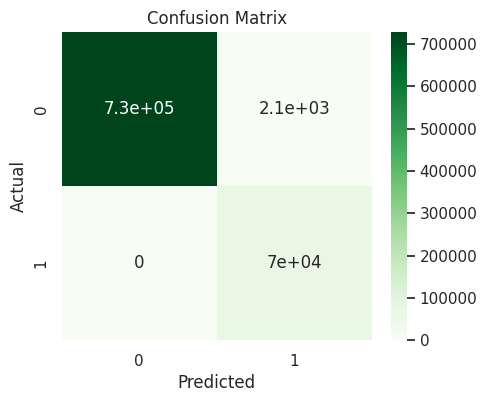

In [39]:
model_evaluation(xgb,X_train,y_train,'Greens',threshold=0.001976)

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    182519
         1.0       0.97      1.00      0.98     17481

    accuracy                           1.00    200000
   macro avg       0.99      1.00      0.99    200000
weighted avg       1.00      1.00      1.00    200000



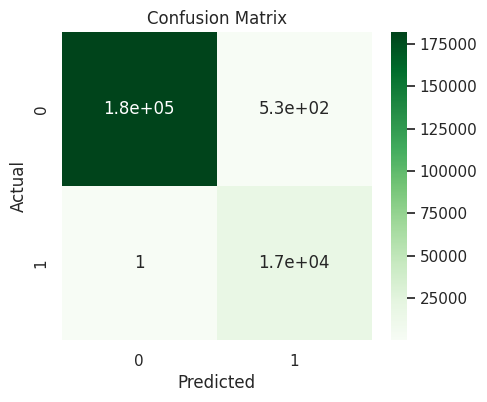

In [40]:
model_evaluation(xgb,X_test,y_test,'Greens',threshold=0.001976)

In [41]:
roc_auc(xgb,X_test,y_test)

Testing ROC-AUC Score:  0.999968204872265


# 3. Random Forest Classifier

In [42]:
rfc = validate(RandomForestClassifier(n_estimators=500 ,n_jobs=-1 ,random_state=42),X_train,y_train,'recall',5)

Cross Validation Scores:  [0.99971396 0.99992849 0.99992849 0.99985699 1.        ]
Scores Mean:  0.9998855855693703
Scores Standard Deviation:  9.700068388970581e-05


In [43]:
precision_recall_trade_off(rfc,X_test,y_test)

    Threshold  Precision  Recall
54      0.120   0.999200     1.0
55      0.124   0.999257     1.0
56      0.128   0.999314     1.0
57      0.130   0.999371     1.0
58      0.136   0.999428     1.0
59      0.146   0.999485     1.0
60      0.150   0.999543     1.0
61      0.154   0.999600     1.0
62      0.190   0.999714     1.0
63      0.212   0.999771     1.0


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    730078
         1.0       1.00      1.00      1.00     69922

    accuracy                           1.00    800000
   macro avg       1.00      1.00      1.00    800000
weighted avg       1.00      1.00      1.00    800000



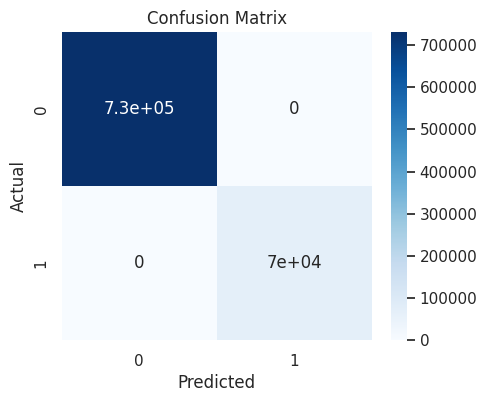

In [44]:
model_evaluation(rfc,X_train,y_train,'Blues',threshold=0.212)

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    182519
         1.0       1.00      1.00      1.00     17481

    accuracy                           1.00    200000
   macro avg       1.00      1.00      1.00    200000
weighted avg       1.00      1.00      1.00    200000



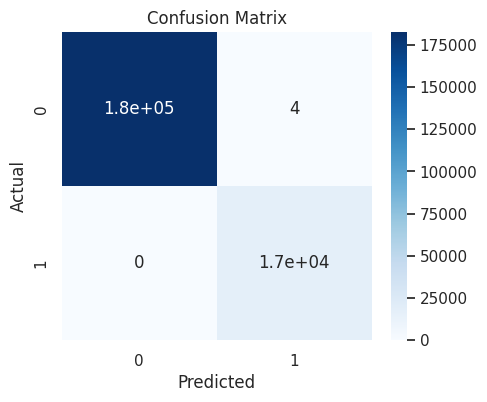

In [45]:
model_evaluation(rfc,X_test,y_test,'Blues',threshold=0.212)

In [46]:
roc_auc(rfc,X_test,y_test)

Testing ROC-AUC Score:  0.9999999987463231


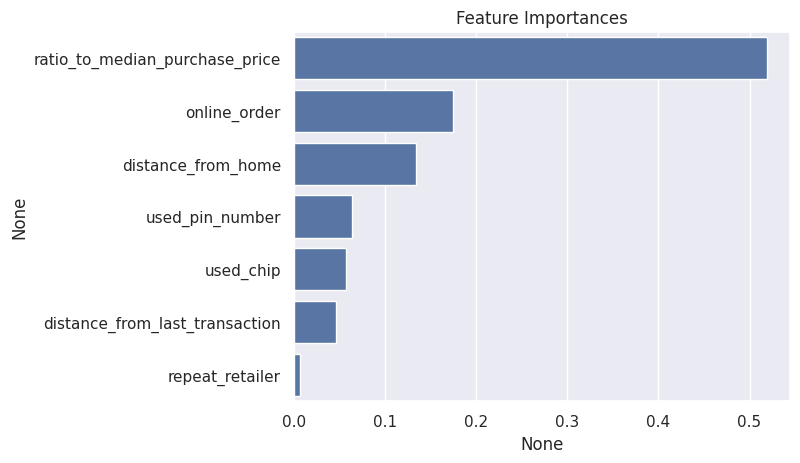

In [47]:
feat_imp_rf = pd.Series(rfc.feature_importances_,index=X.columns).sort_values(ascending=False)
sns.barplot(x=feat_imp_rf,y=feat_imp_rf.index)
plt.title('Feature Importances');

# Conclusion

<ul>
<li>dropping outliers will lead to losing important information
<li>all the features except for repeat_retailer have a moderate to strong correlation with the target.
<li>Decision Tree ,XGBoost and Random Forest achieved great results on both training and test sets (nearly 100% F1 score,100% Recall, 100% ROC-AUC score).
</ul>
